In [238]:
import pandas as pd 
from datetime import datetime
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
pd.set_option('max_columns', None)

In [4]:
#import dataset originally from http://s3.kiva.org/snapshots/kiva_ds_csv.zip
loans = pd.read_csv('C:/Users/mwalz2/Documents/Python/Springboard/Kiva_Capstone_Project/data/raw/loans.csv')

In [5]:
loans.columns

Index(['LOAN_ID', 'LOAN_NAME', 'ORIGINAL_LANGUAGE', 'DESCRIPTION',
       'DESCRIPTION_TRANSLATED', 'FUNDED_AMOUNT', 'LOAN_AMOUNT', 'STATUS',
       'IMAGE_ID', 'VIDEO_ID', 'ACTIVITY_NAME', 'SECTOR_NAME', 'LOAN_USE',
       'COUNTRY_CODE', 'COUNTRY_NAME', 'TOWN_NAME', 'CURRENCY_POLICY',
       'CURRENCY_EXCHANGE_COVERAGE_RATE', 'CURRENCY', 'PARTNER_ID',
       'POSTED_TIME', 'PLANNED_EXPIRATION_TIME', 'DISBURSE_TIME',
       'RAISED_TIME', 'LENDER_TERM', 'NUM_LENDERS_TOTAL',
       'NUM_JOURNAL_ENTRIES', 'NUM_BULK_ENTRIES', 'TAGS', 'BORROWER_NAMES',
       'BORROWER_GENDERS', 'BORROWER_PICTURED', 'REPAYMENT_INTERVAL',
       'DISTRIBUTION_MODEL'],
      dtype='object')

In [6]:
loans.head()

,LOAN_ID,LOAN_NAME,ORIGINAL_LANGUAGE,DESCRIPTION,DESCRIPTION_TRANSLATED,FUNDED_AMOUNT,LOAN_AMOUNT,STATUS,IMAGE_ID,VIDEO_ID,...,LENDER_TERM,NUM_LENDERS_TOTAL,NUM_JOURNAL_ENTRIES,NUM_BULK_ENTRIES,TAGS,BORROWER_NAMES,BORROWER_GENDERS,BORROWER_PICTURED,REPAYMENT_INTERVAL,DISTRIBUTION_MODEL
0,372964,JENELYN,English,"At the age of 20, Jenelyn is married and has o...",NaN,175.0,175.0,funded,952522.0,NaN,...,8.0,7,1,1,NaN,JENELYN,female,true,monthly,field_partner
1,1037234,Zohra\t,English,Zohra is a housewife with four children residi...,Zohra is a housewife with four children residi...,400.0,400.0,funded,2124057.0,NaN,...,13.0,15,2,1,"#Parent, user_favorite",Zohra\t,female,true,monthly,field_partner
2,1037493,Suma Inti Group,Spanish,La A.C. “Suma Inti” iniciará el segundo ciclo ...,The “Suma Inti” communal bank is starting thei...,3400.0,3400.0,funded,2124476.0,NaN,...,10.0,82,3,2,"#Repeat Borrower, user_favorite, user_favorite...","Eliza Betty, Olga, Dora, Aurora, Gladys, Nelly...","female, female, female, female, female, female...","true, true, true, true, true, true, true, true...",monthly,field_partner
3,1800053,Irene,English,Irene is a married woman with five children. S...,Irene is a married woman with five children. S...,150.0,150.0,funded,3204329.0,NaN,...,8.0,6,2,1,"#Woman Owned Biz, user_favorite",Irene,female,true,monthly,field_partner
4,542923,Duo Perlas De Ramirez Group,Spanish,\n\n\nDUO PERLAS DE RAMIREZ\n\nESTA FORMADO PO...,Perlas de Ramirez group.\r\n\r\nThis group has...,775.0,775.0,funded,1321915.0,NaN,...,8.0,29,1,1,NaN,"Sandra, Marta","female, female","true, true",monthly,field_partner


In [7]:
#status of loan is the key outcome 
#The statuses that are relevant for this project are funded or expired (loan did not get 100% funded during funding window)
loans.STATUS.value_counts()/len(loans)

funded         0.947390
expired        0.046875
refunded       0.004599
fundRaising    0.001136
Name: STATUS, dtype: float64

In [8]:
loans.describe().round(2)

,LOAN_ID,FUNDED_AMOUNT,LOAN_AMOUNT,IMAGE_ID,VIDEO_ID,CURRENCY_EXCHANGE_COVERAGE_RATE,PARTNER_ID,LENDER_TERM,NUM_LENDERS_TOTAL,NUM_JOURNAL_ENTRIES,NUM_BULK_ENTRIES
count,1926374.00,1926374.00,1926374.00,1880820.00,1019.00,1534009.00,1906829.00,1926350.00,1926374.00,1926374.00,1926374.00
mean,980993.46,777.81,819.24,1954238.73,2870.06,0.11,164.40,13.14,21.35,1.53,1.14
std,564956.79,1098.04,1209.00,941850.17,1106.04,0.04,102.75,7.30,28.83,1.04,0.50
min,84.00,0.00,25.00,241.00,7.00,0.00,1.00,1.00,0.00,1.00,1.00
25%,493351.25,275.00,275.00,1234500.75,2451.50,0.10,107.00,8.00,8.00,1.00,1.00
50%,980791.50,500.00,500.00,2043564.50,2965.00,0.10,145.00,13.00,14.00,1.00,1.00
75%,1469071.75,925.00,975.00,2769549.25,3544.00,0.10,185.00,14.00,26.00,2.00,1.00
max,1963429.00,100000.00,499975.00,3535083.00,4772.00,0.20,609.00,195.00,3234.00,124.00,62.00


In [ ]:
loans.describe(include=['O'])

In [9]:
#change all of the date columns to datetime to allow for calculations
loans['POSTED_TIME'] = pd.to_datetime(loans['POSTED_TIME'] )
loans['DISBURSE_TIME'] = pd.to_datetime(loans['DISBURSE_TIME'] )
loans['PLANNED_EXPIRATION_TIME']= pd.to_datetime(loans['PLANNED_EXPIRATION_TIME'])
loans['RAISED_TIME']= pd.to_datetime(loans['RAISED_TIME'])

In [12]:
# of loans posted in each year
loans.POSTED_TIME.dt.year.value_counts().sort_index(ascending = False)

2020     57324
2019    219005
2018    229633
2017    225476
2016    197236
2015    181835
2014    174232
2013    140035
2012    133847
2011    113009
2010     92902
2009     81629
2008     50697
2007     26314
2006      3200
Name: POSTED_TIME, dtype: int64

In [35]:
#create new table for loan data for 2nd half of 2019 to be used to build model 
loans_2019 = loans[loans.POSTED_TIME.between('07-01-2019','12-31-2019')].sort_values('POSTED_TIME', ascending = False).reset_index(drop = True).copy()

#export new table to interim dataset 
loans_2019.to_csv('C:/Users/mwalz2/Documents/Python/Springboard/Kiva_Capstone_Project/data/interim/loans_2019.csv', index= False)

In [69]:
#create new table for loan data that includes 110000 loans between 2011-2019
loans_rand = loans[loans.POSTED_TIME.dt.year.between(2011,2019)].sample(n = 110000, random_state = 27) 

#export to new table to interim dataset 
loans_rand.to_csv('C:/Users/mwalz2/Documents/Python/Springboard/Kiva_Capstone_Project/data/interim/loans_rand.csv', index= False)

In [4]:
loans_2019 = pd.read_csv('C:/Users/mwalz2/Documents/Python/Springboard/Kiva_Capstone_Project/data/interim/loans_2019.csv')

In [239]:
loans_2019

,LOAN_ID,LOAN_NAME,ORIGINAL_LANGUAGE,DESCRIPTION,DESCRIPTION_TRANSLATED,FUNDED_AMOUNT,LOAN_AMOUNT,STATUS,IMAGE_ID,ACTIVITY_NAME,SECTOR_NAME,LOAN_USE,COUNTRY_CODE,COUNTRY_NAME,TOWN_NAME,CURRENCY_POLICY,CURRENCY_EXCHANGE_COVERAGE_RATE,CURRENCY,PARTNER_ID,POSTED_TIME,PLANNED_EXPIRATION_TIME,DISBURSE_TIME,RAISED_TIME,RAISED_HOURS,LENDER_TERM,NUM_LENDERS_TOTAL,NUM_BULK_ENTRIES,TAGS,NUM_BORROWERS_TOTAL,BORROWER_NAMES,BORROWER_GENDERS,FEMALE_ONLY_LOAN,BORROWER_PICTURED,REPAYMENT_INTERVAL,DISTRIBUTION_MODEL,AVG_LENDER_AMT
0,1904314,Nainasa,English,57 Year old Nainasa a market seller says that...,57 Year old Nainasa a market seller says that...,700.0,700.0,funded,3335953.0,Fruits & Vegetables,Food,To start planting kava and ginger,FJ,Fiji,Nawamagi,standard,NaN,FJD,562.0,2019-12-30 23:26:32+00:00,2020-02-15 08:00:35+00:00,2019-12-06 08:00:00+00:00,2020-01-01 18:54:49+00:00,43.47,14.0,25,1,"#Woman Owned Biz, #Elderly, user_favorite, #Vegan",1,Nainasa,female,Y,true,monthly,field_partner,28.0
1,1904313,Grupo Las Palmas Monzon Group,Spanish,Francisca es madre de familia con 26 años de e...,Francisca is the mother to a family. She is 2...,150.0,2100.0,expired,3348199.0,Clothing Sales,Clothing,"to buy traditional clothing to sell, such as g...",GT,Guatemala,Suchitepéquez,shared,0.1,GTQ,246.0,2019-12-30 23:16:30+00:00,2020-02-14 12:40:14+00:00,2019-12-07 08:00:00+00:00,NaT,NaN,14.0,6,1,#Parent,3,"Francisca, Manuel, Saqueo","female, male, male",N,"true, true, true",monthly,field_partner,25.0
2,1904312,Nanise,English,Nanise has seen the increase in her clientele ...,Nanise has seen the increase in her clientele ...,3250.0,3250.0,funded,3336034.0,Catering,Food,To buy more catering materials and a bigger st...,FJ,Fiji,Labasa,standard,NaN,FJD,562.0,2019-12-30 23:14:11+00:00,2020-02-16 19:00:11+00:00,2019-11-29 08:00:00+00:00,2020-02-01 13:56:30+00:00,782.71,14.0,114,1,"user_favorite, #Elderly, #Woman Owned Biz, #Re...",1,Nanise,female,Y,true,monthly,field_partner,29.0
3,1904311,Doris,Spanish,Doris es una joven emprendedora que se dedica ...,Doris is a young entrepreneur who has been mak...,900.0,900.0,funded,3348197.0,Bakery,Food,to buy construction materials to enlarge her h...,CR,Costa Rica,San José,shared,0.0,CRC,127.0,2019-12-30 23:03:48+00:00,2020-02-14 12:40:04+00:00,2019-12-13 08:00:00+00:00,2020-01-01 13:54:08+00:00,38.84,26.0,32,1,"user_favorite, #Repeat Borrower, user_favorite...",1,Doris,female,Y,true,monthly,field_partner,28.0
4,1904310,Makitalena,English,Makitalena at just 38 is now finally trying to...,Makitalena at just 38 is now finally trying to...,700.0,700.0,funded,3336041.0,Bakery,Food,"To pay for basic baking items such as trays, h...",FJ,Fiji,Nagigi,standard,NaN,FJD,562.0,2019-12-30 23:01:40+00:00,2020-02-15 08:00:35+00:00,2019-12-05 08:00:00+00:00,2020-01-01 22:30:36+00:00,47.48,14.0,27,1,"#Woman Owned Biz, user_favorite, user_favorite...",1,Makitalena,female,Y,true,monthly,field_partner,26.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109478,1790539,Janelyn,English,Janelyn works hard to support one child.<br />...,Janelyn works hard to support one child.<br />...,125.0,125.0,funded,3191398.0,Personal Housing Expenses,Housing,to build a sanitary toilet for her family.,PH,Philippines,"Kabankalan 2, Negros Occidental",shared,0.1,PHP,145.0,2019-07-01 00:48:44+00:00,2019-07-31 05:30:09+00:00,2019-06-17 07:00:00+00:00,2019-07-01 07:11:01+00:00,6.37,8.0,2,1,NaN,1,Janelyn,female,Y,true,monthly,field_partner,62.0
109479,1790538,Chhainorn,English,"Chhainorn is 49 years old, married and living ...","Chhainorn is 49 years old, married and living ...",1000.0,1000.0,funded,3191394.0,Farming,Agriculture,to buy mushroom spawn and yeast for her farm.,KH,Cambodia,Kampong Cham,shared,0.1,KHR,499.0,2019-07-01 00:35:43+00:00,2019-07-31 05:30:38+00:00,2019-06-12 07:00:00+00:00,2019-07-01 14:33:17+00:00,13.96,26.0,33,1,user_favorite,1,Chhainorn,

In [11]:
#change all of the date columns to datetime to allow for calculations
loans_2019['POSTED_TIME'] = pd.to_datetime(loans_2019['POSTED_TIME'] )
loans_2019['DISBURSE_TIME'] = pd.to_datetime(loans_2019['DISBURSE_TIME'] )
loans_2019['PLANNED_EXPIRATION_TIME']= pd.to_datetime(loans_2019['PLANNED_EXPIRATION_TIME'])
loans_2019['RAISED_TIME']= pd.to_datetime(loans_2019['RAISED_TIME'])

In [14]:
#create pandas profiling report for loans2019
profile = ProfileReport(loans_2019, title='Loans Pandas Profiling Report', explorative = True)

profile

Summarize dataset:   0%|          | 0/47 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [23]:
loans_2019[loans_2019.DISTRIBUTION_MODEL == 'direct'].groupby([loans_2019.STATUS,loans_2019.DISTRIBUTION_MODEL,loans_2019.POSTED_TIME.dt.year]).agg({'LOAN_ID': 'count', 'LOAN_AMOUNT': ['sum','mean']})

LOAN_ID LOAN_AMOUNT             
                                          count         sum         mean
STATUS   DISTRIBUTION_MODEL POSTED_TIME                                 
expired  direct             2019             81    461500.0  5697.530864
funded   direct             2019            327   2056000.0  6287.461774
refunded direct             2019              3     19000.0  6333.333333

In [380]:
pd.set_option('display.max_rows', 500)
loans_2019.groupby(['SECTOR_NAME', 'ACTIVITY_NAME'], as_index = False).LOAN_ID.agg('count').sort_values(by = ['SECTOR_NAME','LOAN_ID'], ascending = [True, False])

,SECTOR_NAME,ACTIVITY_NAME,LOAN_ID
7,Agriculture,Farming,13660
0,Agriculture,Agriculture,3643
11,Agriculture,Pigs,3479
4,Agriculture,Cattle,2227
5,Agriculture,Dairy,1837
12,Agriculture,Poultry,1428
10,Agriculture,Livestock,1421
1,Agriculture,Animal Sales,782
6,Agriculture,Farm Supplies,264
2,Agriculture,Aquaculture,125


In [ ]:
#remove all rows with status = refunded
#what is currency policy(shared vs. standard) and what is currency exchange coverage rate
#determine who is partner iD 145 (20%+ of loans) Philippines Negro Women for Tomorrow Foundation
#what is lender term (int number) - Number of months to repay the loan
#look at extreme values for # of lenders
#drop number of journal entries; almost all values =1 
#determine what bulk entries means consider dropping
#Ask Reza about extracting common words from tags column; how to then utilize
#create column for # of borrowers 
#create column to summarize if there is a woman in the group of borrowers 
#98% of borrowers are pictured should this be dropper?
#could drop borrower name doesn't seem to have relevance... unless we wanted to look at foreign names vs. english names 
#what does bullet repayment - single lump sum 
#should we look at direct and field partner distribution models separately 

In [25]:
#drop video_id column 99% missing & drop number of journal entries column; almost all values =1 

loans_2019.drop(['VIDEO_ID','NUM_JOURNAL_ENTRIES'], axis = 1, inplace = True)

In [72]:
#remove all rows with status = refunded; 623 loans majority of fields are Nan.  This is also not an outcome we are seeking to predict

loans_2019.drop(loans_2019[loans_2019.STATUS =='refunded'].index, inplace = True)

In [88]:
#add another column that calculates the average amount each lender put towards the loan 
loans_2019['AVG_LENDER_AMT'] = round(loans_2019.FUNDED_AMOUNT/loans_2019.NUM_LENDERS_TOTAL,0)

In [234]:
loans_2019.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 108860 entries, 0 to 109482
Data columns (total 36 columns):
 #   Column                           Non-Null Count   Dtype              
---  ------                           --------------   -----              
 0   LOAN_ID                          108860 non-null  int64              
 1   LOAN_NAME                        108859 non-null  object             
 2   ORIGINAL_LANGUAGE                108860 non-null  object             
 3   DESCRIPTION                      108860 non-null  object             
 4   DESCRIPTION_TRANSLATED           108860 non-null  object             
 5   FUNDED_AMOUNT                    108860 non-null  float64            
 6   LOAN_AMOUNT                      108860 non-null  float64            
 7   STATUS                           108860 non-null  object             
 8   IMAGE_ID                         108860 non-null  float64            
 9   ACTIVITY_NAME                    108860 non-null  object   

In [169]:
#create list that contains number of borrowers by counting the number of names associated with each loan
borrower_list = loans_2019['BORROWER_NAMES'].str.split(',')
NUM_BORROWERS_TOTAL =[]
for i, value in borrower_list.items(): 
    if isinstance(value, list):
        NUM_BORROWERS_TOTAL.append(len(value))
    else: 
        NUM_BORROWERS_TOTAL.append(1)

In [176]:
#insert number of borrowers into the loans_2019 dataframe
loans_2019.insert(27,'NUM_BORROWERS_TOTAL',list(NUM_BORROWERS_TOTAL))

In [205]:
#insert column to identify if any male borrowers are part of the loan into loans_2019 dataframe
loans_2019.insert(30,'FEMALE_ONLY_LOAN', 'Y')

In [198]:
#identify any loans that include males 
indices = loans_2019[(loans_2019.BORROWER_GENDERS.notna()) & (loans_2019.BORROWER_GENDERS.str.contains(".*female.*\\bmale.*"))| (loans_2019.BORROWER_GENDERS =='male')].index

In [207]:
#update column to identify loans including males 
loans_2019.loc[indices,'FEMALE_ONLY_LOAN'] ='N'

In [236]:
#Add column that calculates the number of hours that it took to get a loan funded 
loans_2019.insert(23,'RAISED_HOURS',round(pd.to_timedelta(loans_2019.RAISED_TIME - loans_2019.POSTED_TIME)/ pd.Timedelta('1 hour'),2))

In [332]:
#Identify the most common tags 
loan_tags = loans_2019['TAGS'].str.split('#|,')
TAGS_DICT ={}
for i, tags in loan_tags.items():
    if isinstance(tags, list):
        for tag in tags: 
            if tag.strip() in TAGS_DICT:
                TAGS_DICT[tag.strip()] += 1
            else:
                TAGS_DICT[tag.strip()] = 1
del TAGS_DICT['']
sorted(TAGS_DICT.items(), key=lambda x: x[1], reverse =True)

[('user_favorite', 86349),
 ('Woman Owned Biz', 28313),
 ('Parent', 27845),
 ('Repeat Borrower', 19421),
 ('Eco-friendly', 16481),
 ('Health and Sanitation', 14873),
 ('Elderly', 14348),
 ('Schooling', 10497),
 ('Animals', 9720),
 ('Vegan', 7691),
 ('Biz Durable Asset', 7579),
 ('Repair Renew Replace', 4990),
 ('Technology', 4539),
 ('Single Parent', 3325),
 ('volunteer_pick', 2992),
 ('Fabrics', 2975),
 ('Supporting Family', 2749),
 ('Single', 2747),
 ('First Loan', 2423),
 ('Sustainable Ag', 1949),
 ('volunteer_like', 1817),
 ('Widowed', 1690),
 ('Trees', 1248),
 ('Job Creator', 1229),
 ('Refugee', 786),
 ('Unique', 784),
 ('Female Education', 681),
 ('Orphan', 56),
 ('US immigrant', 51)]

In [359]:
#replace all Nan values with empty list to allow for looping
indices = loan_tags[loan_tags.isna()].index
loan_tags[indices]=loan_tags[indices].apply(lambda d: d if isinstance(d, list) else [])

#remove all whitespaces from tags
for i, tags in loan_tags.items():
    loan_tags[i] = [tag.strip() for tag in tags]

In [335]:
#create dataframe with columns corresponding to tags 
tag_df = pd.DataFrame()
column_names = []
tag_present = []

for key in TAGS_DICT.keys():
    column_names.append(key)
    for i, tags in loan_tags.items():
        if (key in tags):
            tag_present.append(1)
        else: 
            tag_present.append(0)
    tag_df[key] = tag_present
    tag_present = []

Woman Owned Biz          27999
Elderly                  14039
user_favorite            47382
Vegan                     7665
Parent                   27744
Repeat Borrower          18654
Repair Renew Replace      4969
Supporting Family         2740
Biz Durable Asset         7528
Unique                     782
Widowed                   1663
Animals                   9459
Single                    2737
Single Parent             3314
volunteer_like            1817
volunteer_pick            2992
Health and Sanitation    14537
Eco-friendly             16206
First Loan                2419
Refugee                    774
Schooling                10148
Technology                4459
Fabrics                   2873
Job Creator               1212
Female Education           676
Sustainable Ag            1942
Trees                     1243
Orphan                      55
US immigrant                50
dtype: int64


In [364]:
#merge dataframe with tag columns to original dataframe 

loans_2019_tags = pd.concat([loans_2019, tag_df], axis=1, join = "inner") 

In [367]:
#Create 2nd pandas profile with the new loans table to identify if additional correlation can be found
profile2 = ProfileReport(loans_2019_tags, title='Loans & Tags Pandas Profiling Report', explorative = True)

profile2

Summarize dataset:   0%|          | 0/79 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

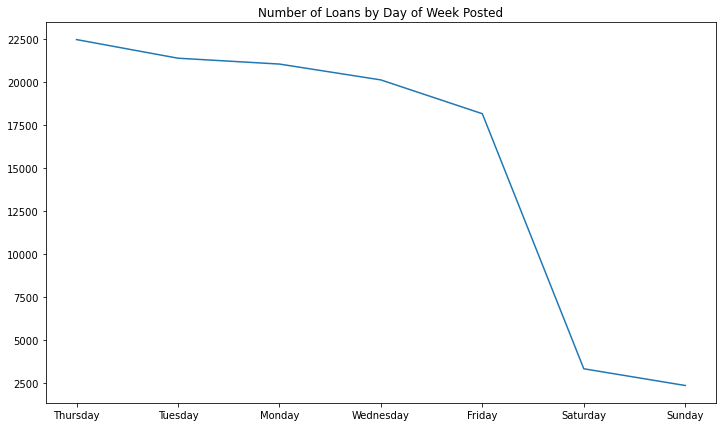

In [377]:
#determine when loans are posted: vast majority of loans are posted during the week
loans_2019.POSTED_TIME.dt.strftime("%A").value_counts().plot(figsize=(12,7))
plt.title('Number of Loans by Day of Week Posted')
plt.show()